<!-- # CNN autoencoder and Clustering from MTRX data

Use this notebook to load Scienta Omicron Matrix format SPM data and create standardised images for machine learning training and analysis. The code can generate both JPG image data, useful for manually checking the data, and windowed numpy data that can be loaded into ML models. 

The notebook then creates an autoencoder for training on a large dataset, followed by KMEANS clustering. 

**Author**: Steven R. Schofield  
**Created**: November, 2024 -->

# Machine learning autoencoder + Kmeans for STM image data analysis
## Steven R. Schofield (Universtiy College London) Dec. 2024.

### Load required modules

In [1]:
# Define path where to find the module. This allows for a different path depending on where the code is running (my mac or the cluster)
import os
import sys

# Define candidate paths
module_path_list = [
    '/Users/steven/academic-iCloud/Python/modules',
    '/hpc/aklicka/Python/modules'
]

data_path_list = [
    '/Users/steven/Python-data',
    '/hpc/aklicka/Python-data/training-set-1'
]

# Resolve actual paths
module_path = next((p for p in module_path_list if os.path.exists(p)), None)
data_path = next((p for p in data_path_list if os.path.exists(p)), None)

# Check and report missing paths
if module_path is None:
    print("Error: Could not locate a valid module path.")
if data_path is None:
    print("Error: Could not locate a valid data path.")

if module_path is None or data_path is None:
    sys.exit(1)

# Print resolved paths
print(f"module_path = {module_path}")
print(f"data_path = {data_path}")

# Reduce TensorFlow verbosity
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'


module_path = /hpc/aklicka/Python/modules
data_path = /hpc/aklicka/Python-data/training-set-1


In [2]:
# # Ensure modules are reloaded 
%load_ext autoreload
%autoreload 2

# Import standard modules
import numpy as np

import platform

from datetime import datetime

# Add custom module path to list
sys.path.append(module_path)

# Import custom module
import SRSML24.data_prep as dp
import SRSML24.model as m
import SRSML24.utils as ut

import tensorflow as tf
#from tensorflow.keras.optimizers.legacy import Adam 
from tensorflow.keras.optimizers import Adam

import matplotlib.pyplot as plt

import pandas as pd
from IPython.display import display, Markdown

import skimage as ski
import skimage.morphology as morphology
import skimage
from skimage import morphology, measure

#import platform 

m.print_system_info()

start_time = dp.current_datetime()


Python version: 3.9.21 (main, Dec 11 2024, 16:24:11) 
[GCC 11.2.0]
TensorFlow version: 2.4.1
TensorFlow is built with CUDA: True
TensorFlow is built with ROCm: False

System: Linux 4.18.0-553.22.1.el8_10.x86_64 (x86_64)
Platform: Linux-4.18.0-553.22.1.el8_10.x86_64-x86_64-with-glibc2.28
Processor: x86_64

Number of GPUs available to TensorFlow: 1
GPU Device: PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')

>>> Running with GPU available <<<  (Linux-4.18.0-553.22.1.el8_10.x86_64-x86_64-with-glibc2.28)

Current time 2025-06-16 09:22:12


### Programme variable setup

In [3]:
# Parameters for windows creation
# General
job_name = 'June_25'
verbose = False             # Set this True to print out more information

# MTRX preprocessing
flatten_method = 'poly_xy'
pixel_density = 15.0        # Convert all images to a constant pixel density
pixel_ratio = 0.7           # If an image has less than this % in the slow scan direction it is discarded
data_scaling = 1.e9         # Scale the z-height of the data

# Windowing
window_size = 32            # Window size for training/validation
window_pitch = 8            # Window pitch for training/validation

# Data saving options
save_windows = True         # Save the windows as numpy files
together = True             # Set this True to save image windows for a mtrx image as a single file rather than separate files.
save_jpg = False            # Save the full image as a jpg
collate = False             # Set this True to remove all subfolder directories and save all data in root data path
save_window_jpgs = False    # Save the windows as jpgs for inspection

# Parameters for training
model_name = 'unet_' + job_name
batch_size = 128
buffer_size = 12800 # shuffling
learning_rate = 1e-4
epochs = 5

# Parameters for clustering
cluster_model_name = model_name + '_kmeans'
cluster_batch_size = 5120 # This is the number of latent features in a batch for clustering. 
                          # Does not have to be the same as for training and probably should 
                          # be larger. 
cluster_buffer_size = cluster_batch_size * 5    # shuffling buffer
num_clusters=20                                 # Desired number of clusters (centroids) to form in the data.
max_iter=1000                                   # Maximum iterations allowed for each mini-batch to refine centroids.
reassignment_ratio=0.05                         # Fraction of clusters reassigned per step; lower values stabilize updates.

# Parameters for PREDICTIONS
predict_window_pitch = 2                        # Window pitch for prediction
predictions_batch_size = 2**15                  # Batch size for predictions


# DATA LIMITS FOR TESTING THE CODE
mtrx_train_data_limit = 200                    # Number of MTRX files to process (training)
mtrx_test_data_limit = 50                     # Number of MTRX files to process (validation)

train_data_limit = None                         # Limit the data used in the autoencoder training
test_data_limit = None                          # Limit the data used in the autoencoder training (validation)

In [48]:

job_data_path = dp.create_new_data_path(data_path, job_name, include_date=False)

mtrx_train_path = os.path.join(data_path, 'mtrx/train')
mtrx_test_path = os.path.join(data_path, 'mtrx/test')
mtrx_predict_path = os.path.join(data_path, 'mtrx/predict')

model_path = os.path.join(job_data_path,'model')
cluster_model_path = os.path.join(job_data_path,'cluster_model')

latent_features_path = os.path.join(job_data_path, 'latent_features')
predict_latent_features_path = os.path.join(job_data_path, 'latent_features_predictions')

windows_train_path = os.path.join(job_data_path, 'windows/train')
windows_test_path = os.path.join(job_data_path, 'windows/test')
windows_predict_path = os.path.join(job_data_path, 'windows/predict')

predictions_path = os.path.join(job_data_path, f'predictions')

feature_windows_path = os.path.join(job_data_path, 'feature_windows')
feature_windows_latent_path = os.path.join(job_data_path, 'feature_windows_latent')
feature_predictions_path = os.path.join(job_data_path, 'feature_predictions')

cluster_model_feature_windows_path = os.path.join(job_data_path, 'cluster_model_feature_windows')

### Process Matrix format data to windows for autoencoder training and validation

In [20]:
# REMOVE ALL DATA FOLDERS EXCEPT MTRX 
dp.delete_data_folders(job_data_path, subdirectories=["jpg", "windows", "windows-jpg"], override=True)

Deleted: /hpc/aklicka/Python-data/training-set-1/June_25/windows
All specified folders have been successfully deleted.


In [21]:
# Training data
mtrx_train_file_list, _ = dp.list_files_by_extension(mtrx_train_path,'Z_mtrx',verbose=False)

dp.process_mtrx_files(
    mtrx_train_file_list[0:mtrx_train_data_limit],
    job_data_path, # save data path
    flatten_method = flatten_method, pixel_density = pixel_density, pixel_ratio = pixel_ratio,
    data_scaling = data_scaling, window_size = window_size, window_pitch = window_pitch,
    save_windows = save_windows,
    save_window_jpgs=save_window_jpgs,
    save_jpg = save_jpg,
    together = together,
    collate = collate,
    verbose = verbose
    )

# Test data
mtrx_test_file_list, _ = dp.list_files_by_extension(mtrx_test_path,'Z_mtrx',verbose=False)

dp.process_mtrx_files(
    mtrx_test_file_list[0:mtrx_test_data_limit],
    job_data_path, # save data path
    flatten_method = flatten_method, pixel_density = pixel_density, pixel_ratio = pixel_ratio,
    data_scaling = data_scaling, window_size = window_size, window_pitch = window_pitch,
    save_windows = save_windows,
    save_window_jpgs=save_window_jpgs,
    save_jpg = save_jpg,
    together = together,
    collate = collate,
    verbose = verbose
    )

Found 1973 files with extension 'Z_mtrx' in directory:
/hpc/aklicka/Python-data/training-set-1/mtrx/train
There are 200 files to process
....t...t....t....................t.t............ttt.......t.......t.....ttt.t............tt..tttt. 100
t........t......ttt..t..tt.ttt.........t..t....tt.t.tt..tt...tttttttttttttttttttttt.ttt.ttt.tt..ttt 200
t
********************
Conversion complete.
********************

Found 452 files with extension 'Z_mtrx' in directory:
/hpc/aklicka/Python-data/training-set-1/mtrx/test
There are 50 files to process
..t.....................t.t.....t.................
********************
Conversion complete.
********************



### Build tensorflow data pipeline for training and validation of autoencoder

In [22]:
# Training data - tensorflow data pipeline for autoencoder
train_files, num_train = dp.list_files_by_extension(windows_train_path, 'npy')
train_files = train_files[:train_data_limit]

# Create dataset with prefetching
train_dataset = m.create_tf_dataset_batched(
    train_files, 
    batch_size=batch_size, 
    buffer_size=buffer_size, 
    window_size=window_size,
    is_autoencoder=True, 
    shuffle=True)

# Validation data - tensorflow data pipeline for autoencoder
test_files, num_test = dp.list_files_by_extension(windows_test_path, 'npy')
test_files = test_files[:test_data_limit]

# Create dataset with prefetching
test_dataset = m.create_tf_dataset_batched(
    test_files, 
    batch_size=batch_size, 
    buffer_size=buffer_size, 
    window_size=window_size,
    is_autoencoder=True, 
    shuffle=True)

Found 217 files with extension 'npy' in directory:
/hpc/aklicka/Python-data/training-set-1/June_25/windows/train
Data pipeline created with 217 files, batch size: 128, window size: 32
Sample batch shape: (128, 32, 32, 1)

Found 8 files with extension 'npy' in directory:
/hpc/aklicka/Python-data/training-set-1/June_25/windows/test
Data pipeline created with 8 files, batch size: 128, window size: 32
Sample batch shape: (128, 32, 32, 1)



In [23]:
# Build and compile the UNET model
autoencoder_model = m.build_autoencoder(window_size=window_size,model_name=model_name)
autoencoder_model.summary()
m.save_model_summary(autoencoder_model, model_path, model_name=model_name)

# Can also save a graphical representation of the model
# This requires pydot and graphviz to be installed
# pip install pydot
# pip install graphviz
# If you are using a Mac, you may need to install graphviz using brew
# brew install graphviz
m.save_model_diagram(autoencoder_model, model_path, model_name=model_name, show_shapes=False, show_layer_names=False, expand_nested=False)

# Check if running on Apple Silicon
is_mac_silicon = platform.system() == "Darwin" and platform.processor() == "arm"

if is_mac_silicon:
    print("Detected Mac with Apple Silicon. Compiling the model with the legacy RMSprop optimizer for compatibility with TensorFlow-metal.")
    autoencoder_model.compile(
        optimizer=tf.keras.optimizers.legacy.RMSprop(learning_rate=learning_rate),
        loss='mean_squared_error',
        metrics=['mse', 'mae']
    )
else:
    print("Compiling the model with the RMSprop optimizer.")
    autoencoder_model.compile(
        optimizer=tf.keras.optimizers.RMSprop(learning_rate=learning_rate),
        loss='mean_squared_error',
        metrics=['mse', 'mae']
    )



Model: "unet_June_25"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input (InputLayer)              [(None, 32, 32, 1)]  0                                            
__________________________________________________________________________________________________
conv1 (Conv2D)                  (None, 32, 32, 32)   320         input[0][0]                      
__________________________________________________________________________________________________
drop1 (Dropout)                 (None, 32, 32, 32)   0           conv1[0][0]                      
__________________________________________________________________________________________________
pool1 (MaxPooling2D)            (None, 16, 16, 32)   0           drop1[0][0]                      
_______________________________________________________________________________________

### Train autoencoder

In [24]:
# Train the model using the tf.data datasets
history = autoencoder_model.fit(
    train_dataset,
    validation_data=test_dataset,
    epochs=epochs,
    shuffle=True,
    verbose=1
)
model_train_time = datetime.now().strftime('%Y%m%d_%H%M%S')
print(f"Model training completed at {model_train_time}")

# Save the model as soon as training completes
m.save_model(autoencoder_model, model_path, model_name=model_name, model_train_time=model_train_time)

end_time = dp.current_datetime()
dp.elapsed_time(start_time,end_time)

Epoch 1/5
5959/5959 [==============================] - 590s 98ms/step - loss: 0.0042 - mse: 0.0042 - mae: 0.0419 - val_loss: 2.9081e-04 - val_mse: 2.9081e-04 - val_mae: 0.0135
Epoch 2/5
5959/5959 [==============================] - 1216s 204ms/step - loss: 1.1643e-04 - mse: 1.1643e-04 - mae: 0.0087 - val_loss: 5.9069e-04 - val_mse: 5.9069e-04 - val_mae: 0.0218
Epoch 3/5
5959/5959 [==============================] - 1138s 191ms/step - loss: 6.0952e-05 - mse: 6.0952e-05 - mae: 0.0065 - val_loss: 1.8222e-04 - val_mse: 1.8222e-04 - val_mae: 0.0106
Epoch 4/5
5959/5959 [==============================] - 1190s 200ms/step - loss: 4.2544e-05 - mse: 4.2544e-05 - mae: 0.0055 - val_loss: 3.7026e-04 - val_mse: 3.7026e-04 - val_mae: 0.0168
Epoch 5/5
5959/5959 [==============================] - 1214s 204ms/step - loss: 3.2335e-05 - mse: 3.2335e-05 - mae: 0.0047 - val_loss: 1.3039e-04 - val_mse: 1.3039e-04 - val_mae: 0.0082
Model training completed at 20250606_130337
Model saved at: /hpc/aklicka/Python-

### Extract Latent Features

In [25]:
dp.delete_data_folders(
    job_data_path, 
    subdirectories='latent_features',
    override=True)

Deleted: /hpc/aklicka/Python-data/training-set-1/June_25/latent_features
All specified folders have been successfully deleted.


In [26]:
# Load the trained autoencoder model
autoencoder_model = m.load_model(model_path, model_name=model_name)

Model loaded from: /hpc/aklicka/Python-data/training-set-1/June_25/model/unet_June_25.keras


In [27]:
# Training data - tensorflow data pipeline 
train_files, num_train = dp.list_files_by_extension(windows_train_path, 'npy')
train_files = train_files[:train_data_limit]

train_dataset = m.create_tf_dataset_batched(
    train_files, 
    batch_size=cluster_batch_size, 
    buffer_size=cluster_buffer_size, 
    window_size=window_size,
    is_autoencoder=True, 
    shuffle=True)

Found 217 files with extension 'npy' in directory:
/hpc/aklicka/Python-data/training-set-1/June_25/windows/train
Data pipeline created with 217 files, batch size: 5120, window size: 32
Sample batch shape: (5120, 32, 32, 1)



In [28]:
m.extract_latent_features_to_disk_from_prebatched_windows(
    autoencoder_model, 
    train_dataset, 
    latent_features_path, 
    bottleneck_layer_name='bottleneck',
    features_name='latent_features_train',
    return_array=False,
    verbose=False)

....................................................................................................100
................................................
All latent features have been saved to /hpc/aklicka/Python-data/training-set-1/June_25/latent_features.
Sample batch shape: (5120, 4096)


### Train KMEANS using latent features saved to disk

In [5]:
# List and sort latent feature files
latent_features_files, num_latent_files = dp.list_files_by_extension(latent_features_path, 'npy')

Found 434 files with extension 'npy' in directory:
/hpc/aklicka/Python-data/training-set-1/June_25_BIG_model/latent_features


In [6]:
# Load the latent features from disk into a tensor dataset pipeline
latent_features_dataset = m.create_latent_features_tf_dataset(
    latent_features_files,
    batch_size=cluster_batch_size,
    shuffle=True, 
    shuffle_buffer_size=cluster_buffer_size)

Data pipeline created with 434 files, batch size: 5120
Shuffling enabled with buffer size: 25600
Batch shape: (5120, 4096)


Batch 1 processed. Inertia: 407.18695068359375
Batch 2 processed. Inertia: 407.9449768066406
Batch 3 processed. Inertia: 430.5960998535156
Batch 4 processed. Inertia: 419.684326171875
Batch 5 processed. Inertia: 400.8091735839844
Batch 6 processed. Inertia: 413.09796142578125
Batch 7 processed. Inertia: 406.392333984375
Batch 8 processed. Inertia: 432.6946105957031
Batch 9 processed. Inertia: 425.6654968261719
Batch 10 processed. Inertia: 412.17095947265625
Batch 11 processed. Inertia: 421.1836853027344
Batch 12 processed. Inertia: 435.2585754394531
Batch 13 processed. Inertia: 414.65960693359375
Batch 14 processed. Inertia: 396.0166015625
Batch 15 processed. Inertia: 440.2654113769531
Batch 16 processed. Inertia: 420.6568603515625
Batch 17 processed. Inertia: 405.8493957519531
Batch 18 processed. Inertia: 425.1768798828125
Batch 19 processed. Inertia: 405.3933410644531
Batch 20 processed. Inertia: 414.8550109863281
Batch 21 processed. Inertia: 415.5833435058594
Batch 22 processed. Ine

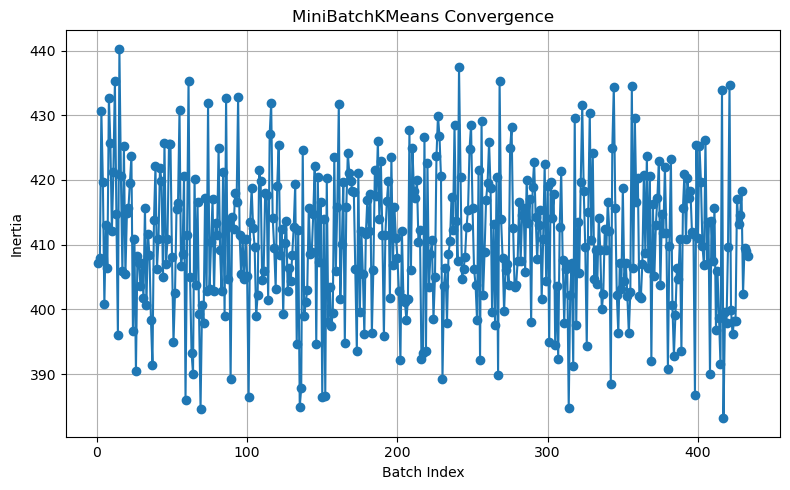

Cluster model saved at: /hpc/aklicka/Python-data/training-set-1/June_25_BIG_model/cluster_model/unet_June_25_BIG_model_kmeans.pkl


In [7]:

cluster_model, convergence_history = m.train_kmeans(
    latent_features_dataset,                # tf.data.Dataset containing batches of latent feature vectors.
    batch_size=cluster_batch_size,          # Size of each batch for the KMeans model (controls memory usage and stability).
    num_clusters=num_clusters,              # Desired number of clusters (centroids) to form in the data.
    max_iter=5000000,                      # Maximum iterations allowed for each mini-batch to refine centroids.
    reassignment_ratio=0.01   # Fraction of clusters reassigned per step; lower values stabilize updates.
)
# Save and plot convergence history
m.plot_kmeans_convergence(convergence_history, cluster_model_path, model_name=cluster_model_name)

# Save cluster model
m.save_cluster_model(cluster_model, cluster_model_path, model_name=cluster_model_name)

### Process Matrix format data to windows for making predictions 

In [5]:
dp.delete_data_folders(
    job_data_path, 
    subdirectories=['windows/predict','windows-jpg/predict','jpg/predict'],
    override=True)

Deleted: /hpc/aklicka/Python-data/training-set-1/June_25/windows/predict
All specified folders have been successfully deleted.


In [6]:
# Prediction data in MTRX format
mtrx_predict_file_list, _ = dp.list_files_by_extension(mtrx_predict_path,'Z_mtrx',verbose=False)

dp.process_mtrx_files(
    mtrx_predict_file_list,
    job_data_path, # save data path
    flatten_method = flatten_method, pixel_density = pixel_density, pixel_ratio = pixel_ratio,
    data_scaling = data_scaling, window_size = window_size, 
    window_pitch = predict_window_pitch,
    save_windows = save_windows,
    save_window_jpgs=save_window_jpgs,
    save_jpg = save_jpg,
    together = together,
    collate = collate,
    verbose = verbose
)

Found 17 files with extension 'Z_mtrx' in directory:
/hpc/aklicka/Python-data/training-set-1/mtrx/predict
There are 17 files to process
........ttttttttt
********************
Conversion complete.
********************



### Make predictions using the trained autoencoder and KMEANS models

In [49]:
# Load the trained autoencoder
autoencoder_model = m.load_model(model_path, model_name=model_name)

# Load a previously saved cluster model from disk
cluster_model = m.load_cluster_model(cluster_model_path, model_name=cluster_model_name)

Model loaded from: /hpc/aklicka/Python-data/training-set-1/June_25/model/unet_June_25.keras
Cluster model loaded from: /hpc/aklicka/Python-data/training-set-1/June_25/cluster_model/unet_June_25_kmeans.pkl


In [50]:
# Training data - tensorflow data pipeline 
train_files, num_train = dp.list_files_by_extension(windows_train_path, 'npy')
train_files = train_files[:train_data_limit]

# Get the corresponding image coordimages list file
image_windows_coordinates_file_list , _ = dp.list_files_by_extension(windows_train_path,'.txt',verbose=False)
image_windows_coordinates_file_list = [
    name for name in image_windows_coordinates_file_list 
    if "coordinates" in name
]


Found 217 files with extension 'npy' in directory:
/hpc/aklicka/Python-data/training-set-1/June_25/windows/train
Found 434 files with extension '.txt' in directory:
/hpc/aklicka/Python-data/training-set-1/June_25/windows/train


In [ ]:
# Get the list of image windows files to make predictions on
#predict_data_files_list, predict_data_files_num = dp.list_files_by_extension(windows_predict_path,'.npy',verbose=False)
## Get the corresponding image coordimages list file
#image_windows_coordinates_file_list , _ = dp.list_files_by_extension(windows_predict_path,'.txt',verbose=False)
#image_windows_coordinates_file_list = [
#    name for name in image_windows_coordinates_file_list 
#    if "coordinates" in name
#]#

Found 32 files with extension '.npy' in directory:
/hpc/aklicka/Python-data/training-set-1/June_25/windows/predict
Found 64 files with extension '.txt' in directory:
/hpc/aklicka/Python-data/training-set-1/June_25/windows/predict


In [51]:
ut.summarize_parameters(['job_name', 'flatten_method', 'pixel_density', 'pixel_ratio', 'data_scaling', 'window_size', 
                      'window_pitch', 'model_name', 'model_train_time', 'batch_size', 'buffer_size', 'learning_rate', 
                      'epochs', 'cluster_model_name', 'cluster_batch_size', 'cluster_buffer_size', 'num_clusters', 
                      'max_iter', 'reassignment_ratio', 'predict_window_pitch', 'mtrx_train_data_limit', 
                      'mtrx_test_data_limit', 'train_data_limit', 'test_data_limit',], save_path=predictions_path)


Saved parameter summary to /hpc/aklicka/Python-data/training-set-1/June_25/predictions/parameter_summary_20250616_103131.csv


,Parameter,Value
0,job_name,June_25
1,flatten_method,poly_xy
2,pixel_density,15.0
3,pixel_ratio,0.7
4,data_scaling,1000000000.0
5,window_size,32
6,window_pitch,8
7,model_name,unet_June_25
8,model_train_time,undefined
9,batch_size,128


In [156]:

## Make predictions on the image windows and save the latent features to disk
#for prediction_file, coords_file in zip(predict_data_files_list,image_windows_coordinates_file_list):
#    # Load the windows for the image as a numpy file
#    image_windows = np.load(prediction_file)
#    # Load the image window coordinates
#    image_windows_coordinates = dp.load_coordinates_file(coords_file)
#    # Reconstruct the original image from the loaded image windows
#    reconstructed_img = dp.reconstruct_image(image_windows,image_windows_coordinates,window_size)
#    
#    # Make a tensorflow data pipeline of just the image windows for this image.
#    num_windows = image_windows.shape[0]
#    print('\n---\nProcessing file {}'.format(os.path.basename(prediction_file)))
#   
#    # Predictions windows
#    predict_dataset = m.create_tf_dataset_batched(
#        [prediction_file], 
#        batch_size=predictions_batch_size, 
#        window_size=window_size,
#        is_autoencoder=False, 
#        shuffle=False)
#   
#    # make the latent features for each window using the autoencoder model 
#    latent_predict_features, num_latent_predictions = m.extract_latent_features_to_disk_from_prebatched_windows(
#        autoencoder_model, 
#        predict_dataset, 
#        '',                 # we are not saving these predictions to disk so don't need a folder or name
#        features_name='',
#        return_array=True,
#        verbose=False)
#    
#    # make preductions 
#    cluster_predictions = cluster_model.predict(latent_predict_features)
#    
#    # Build the reconstruction of the predicted cluster label data
#    cluster_img = dp.reconstruct_cluster_image(image_windows_coordinates,window_size, cluster_predictions)
#    
#    # Pad the cluster image to the original image size
#    cluster_img = ut.padded_cluster_img = ut.pad_cluster_image(reconstructed_img,cluster_img,window_size)
#    image_name = os.path.splitext(os.path.basename(prediction_file))[0]
#  
#  #  label_stats, background_labels = m.analyse_cluster_labels(cluster_img, large_region_thresh=0.005)
#  #  cluster_img = m.relabel_background(cluster_img, background_labels)
#
#    # Save the cluster image to disk
#    m.display_reconstructed_and_cluster_images(reconstructed_img,cluster_img,
#                                                show_overlay=True,
#                                                save_to_disk=True,
#                                                output_path=predictions_path,
#                                                image_name=image_name,
#                                                dpi=150)  
#    #

In [52]:
max_size_blob = 3000 #maximum pixel area of a blob to keep in the image
area_threshold = 50 #minimum pixel area of a blob to keep in the image
feature_size = 16 #radius of feature window taken from the centroid of the blob, actual window size is 2*feature_size

In [53]:
dp.delete_data_folders(job_data_path, subdirectories=["feature_windows"], override=True)

for image_num in range(len(train_files)):
    prediction_file = train_files[image_num]  
    coords_file = image_windows_coordinates_file_list[image_num]  

    #get reconstructed image and cluster image
    reconstructed_img, cluster_img = m.reconstruct_predict(prediction_file, coords_file, autoencoder_model, cluster_model, window_size, predictions_batch_size)

    # Detect features and find centers
    labeled_array, centers, num_features = m.detect_features_better(cluster_img, max_size=max_size_blob, area_threshold=area_threshold)

    #extract feature windows from the reconstructed image
    feature_windows = m.extract_feature_windows(reconstructed_img, centers, px=feature_size)

    image_name = os.path.splitext(os.path.basename(prediction_file))[0]
    # Save the feature windows to disk for each reconstructed image
    dp.save_feature_windows_together(feature_windows, centers, feature_windows_path, base_filename=image_name, verbose=True)

    #save / display the reconstructed and cluster images with centers highlighted
    m.display_reconstructed_and_cluster_images_and_extracted_features(reconstructed_img, cluster_img, labeled_array, centers,
                                                                      save_to_disk=True, output_path=feature_predictions_path, image_name=image_name, dpi=150)

Deleted: /hpc/aklicka/Python-data/training-set-1/June_25/feature_windows
All specified folders have been successfully deleted.

---
Processing file default_2011Jan07-144939_STM-STM_Spectroscopy--14_1_BU_all_windows.npy
Not shuffling
Data pipeline created with 1 files, batch size: 32768, window size: 32
Sample batch shape: (1156, 32, 32, 1)
.Combined latent features shape: (1156, 4096)
Saved 0 windows to /hpc/aklicka/Python-data/training-set-1/June_25/feature_windows/default_2011Jan07-144939_STM-STM_Spectroscopy--14_1_BU_all_windows_all_windows.npy
Saved coordinates to /hpc/aklicka/Python-data/training-set-1/June_25/feature_windows/default_2011Jan07-144939_STM-STM_Spectroscopy--14_1_BU_all_windows_coordinates.txt

Directory created: /hpc/aklicka/Python-data/training-set-1/June_25/feature_predictions
Image saved to /hpc/aklicka/Python-data/training-set-1/June_25/feature_predictions/default_2011Jan07-144939_STM-STM_Spectroscopy--14_1_BU_all_windows.jpg with dpi=150

---
Processing file de

### Create latent vectors from feature windows

In [54]:
# Load the trained autoencoder model
autoencoder_model = m.load_model(model_path, model_name=model_name)

Model loaded from: /hpc/aklicka/Python-data/training-set-1/June_25/model/unet_June_25.keras


In [55]:
# Training data - tensorflow data pipeline 
train_files, num_train = dp.list_files_by_extension(feature_windows_path, 'npy')
train_files = train_files[:train_data_limit]

train_dataset = m.create_tf_dataset_batched(
    train_files, 
    batch_size=cluster_batch_size, 
    buffer_size=cluster_buffer_size, 
    window_size=feature_size*2,  # feature windows are 2*feature_size
    is_autoencoder=True, 
    shuffle=True)

Found 217 files with extension 'npy' in directory:
/hpc/aklicka/Python-data/training-set-1/June_25/feature_windows
Data pipeline created with 217 files, batch size: 5120, window size: 32
Sample batch shape: (2914, 32, 32, 1)



Batch 0:
x shape: (2914, 32, 32, 1), y shape: (2914, 32, 32, 1)


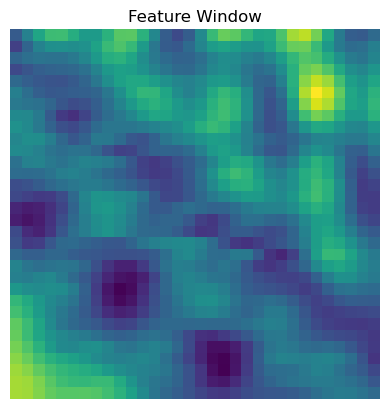

In [57]:
# show one image with specific index from train_dataset
for i, (x, y) in enumerate(train_dataset):
    if i == 0:  # Show only the first batch
        print(f"Batch {i}:")
        print(f"x shape: {x.shape}, y shape: {y.shape}")
        plt.imshow(x[2].numpy().squeeze(), cmap='viridis')
        plt.title('Feature Window')
        plt.axis('off')
        plt.show()
    break


In [58]:
m.extract_latent_features_to_disk_from_prebatched_windows(
    autoencoder_model, 
    train_dataset, 
    feature_windows_latent_path, 
    bottleneck_layer_name='bottleneck',
    features_name='feature_windows_latent_features_train',
    return_array=False,
    verbose=True)

Processing batch 1, input shape: [2914   32   32    1]
Latent features shape for batch 1: (2914, 4096)
Saved latent features for batch 1 to /hpc/aklicka/Python-data/training-set-1/June_25/feature_windows_latent/feature_windows_latent_features_train_batch_0.npy

All latent features have been saved to /hpc/aklicka/Python-data/training-set-1/June_25/feature_windows_latent.
Sample batch shape: (2914, 4096)


### Train K-Means using latent features saved to disk

In [59]:
# List and sort latent feature files
feature_windows_latent_features_files, num_latent_files = dp.list_files_by_extension(feature_windows_latent_path, 'npy')

Found 1 files with extension 'npy' in directory:
/hpc/aklicka/Python-data/training-set-1/June_25/feature_windows_latent


In [60]:
print(feature_windows_latent_features_files)

['/hpc/aklicka/Python-data/training-set-1/June_25/feature_windows_latent/feature_windows_latent_features_train_batch_0.npy']


In [61]:
# simple method for kmeans
def load_numpy_file(file_path):
        data = np.load(file_path)
        return data

def tf_load_numpy_file(file_path):
    data = tf.py_function(load_numpy_file, [file_path], tf.float32)
    return tf.data.Dataset.from_tensor_slices(data)

data = load_numpy_file(feature_windows_latent_features_files[0])

from sklearn.cluster import KMeans
#from sklearn.metrics import silhouette_score
#
#kmeans = KMeans(n_clusters=4, random_state=42)
#labels = kmeans.fit_predict(data)
#
#sil_score = silhouette_score(data, labels)
#print(f"Silhouette Score: {sil_score:.3f}")#

In [62]:
# Load the latent features from disk into a tensor dataset pipeline
feature_windows_latent_features_dataset = m.create_latent_features_tf_dataset(
    feature_windows_latent_features_files,
    batch_size=cluster_batch_size,
    shuffle=True, 
    shuffle_buffer_size=cluster_buffer_size)

Data pipeline created with 1 files, batch size: 5120
Shuffling enabled with buffer size: 25600
Batch shape: (2914, 4096)


In [63]:

cluster_model, convergence_history = m.train_kmeans(
    feature_windows_latent_features_dataset,                # tf.data.Dataset containing batches of latent feature vectors.
    batch_size=cluster_batch_size,          # Size of each batch for the KMeans model (controls memory usage and stability).
    num_clusters=4,              # Desired number of clusters (centroids) to form in the data.
    max_iter=5000000,                      # Maximum iterations allowed for each mini-batch to refine centroids.
    reassignment_ratio=0.01   # Fraction of clusters reassigned per step; lower values stabilize updates.
)
# Save and plot convergence history
m.plot_kmeans_convergence(convergence_history, cluster_model_path, model_name=cluster_model_name)

# Save cluster model
m.save_cluster_model(cluster_model, cluster_model_path, model_name=cluster_model_name)

Batch 1 processed. Inertia: 422.6554870605469
[Warning] Not enough data to plot convergence.
Cluster model saved at: /hpc/aklicka/Python-data/training-set-1/June_25/cluster_model/unet_June_25_kmeans.pkl


In [64]:
print(cluster_model.cluster_centers_.shape)


(4, 4096)


In [65]:
from sklearn.metrics import calinski_harabasz_score
from sklearn.metrics import silhouette_score

labels = cluster_model.labels_
score = calinski_harabasz_score(data, labels)
print(f"Calinski-Harabasz Score: {score:.3f}")

sil_score = silhouette_score(data, labels)
print(f"Silhouette Score: {sil_score:.3f}")#

Calinski-Harabasz Score: 568.300
Silhouette Score: 0.169


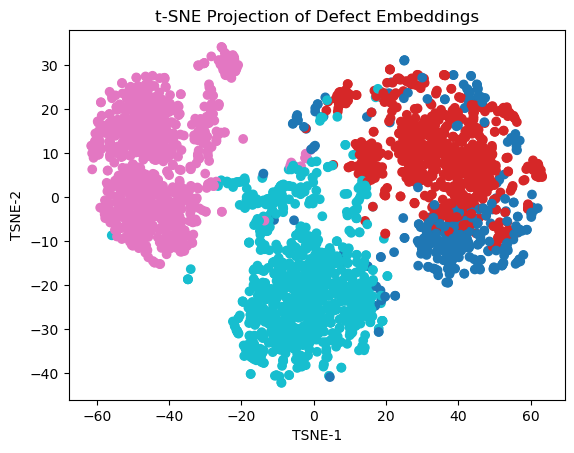

In [66]:
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

tsne = TSNE(n_components=2, perplexity=50, random_state=42)
latent_2d = tsne.fit_transform(data)

plt.scatter(latent_2d[:, 0], latent_2d[:, 1], c=labels, cmap='tab10')
plt.title('t-SNE Projection of Defect Embeddings')
plt.xlabel('TSNE-1')
plt.ylabel('TSNE-2')
plt.show()


In [67]:
print(labels[50:60])

[1 1 2 2 2 3 3 2 2 3]


Batch 0:
x shape: (2914, 32, 32, 1), y shape: (2914, 32, 32, 1)


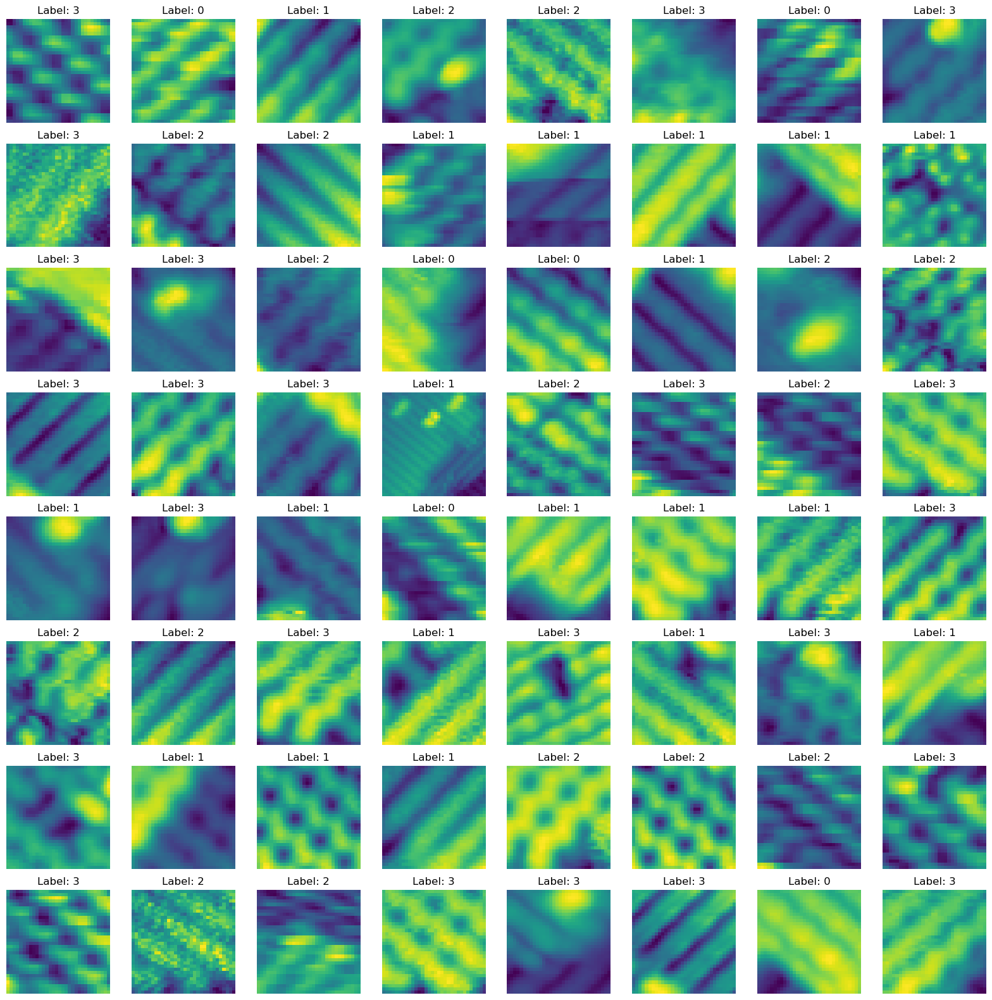

In [68]:
# Display the first 16 images in a 4x4 grid along with their labels
def display_images_with_labels(images, labels, num_images=16):
    plt.figure(figsize=(12, 12))
    for i in range(num_images):
        plt.subplot(4, 4, i + 1)
        plt.imshow(images[i].squeeze(), cmap='viridis')
        plt.title(f'Label: {labels[i]}')
        plt.axis('off')
    plt.tight_layout()
    plt.show()

num_images = 64
# show one image with specific index from train_dataset
for i, (x, y) in enumerate(train_dataset):
    if i == 0:  # Show only the first batch
        print(f"Batch {i}:")
        print(f"x shape: {x.shape}, y shape: {y.shape}")
        plt.figure(figsize=(20, 20))
        for index in range(num_images):
            plt.subplot(8, 8, index + 1)
            plt.imshow(x[index].numpy().squeeze(), cmap='viridis')
            plt.title(f'Label: {labels[index]}')
            plt.axis('off')
        
        plt.show()
    break


In [179]:
# Load the latent features from disk into a tensor dataset pipeline
latent_features_dataset = m.create_latent_features_tf_dataset(
    feature_windows_latent_features_files,
    batch_size=cluster_batch_size,
    shuffle=True, 
    shuffle_buffer_size=cluster_buffer_size)

Data pipeline created with 1 files, batch size: 5120
Shuffling enabled with buffer size: 25600
Batch shape: (1471, 4096)


In [186]:

cluster_model_feature_windows, convergence_history = m.train_kmeans(
    latent_features_dataset,                # tf.data.Dataset containing batches of latent feature vectors.
    batch_size=cluster_batch_size,          # Size of each batch for the KMeans model (controls memory usage and stability).
    num_clusters=4,              # Desired number of clusters (centroids) to form in the data.
    max_iter=5000000,                      # Maximum iterations allowed for each mini-batch to refine centroids.
    reassignment_ratio=0.01   # Fraction of clusters reassigned per step; lower values stabilize updates.
)
# Save and plot convergence history
m.plot_kmeans_convergence(convergence_history, cluster_model_feature_windows_path, model_name=cluster_model_name)

# Save cluster model
m.save_cluster_model(cluster_model_feature_windows, cluster_model_feature_windows_path, model_name=cluster_model_name)

Batch 1 processed. Inertia: 235.81414794921875
[Warning] Not enough data to plot convergence.
Cluster model saved at: /hpc/aklicka/Python-data/training-set-1/June_25/cluster_model_feature_windows/unet_June_25_kmeans.pkl


In [35]:
data = cluster_img.astype("int32")
print(np.bincount(data.ravel()))

[ 54592   7856   9768    112 169872  15052    652      0      0      0
      0   4856      0      0   1800  12212  16324 516636      0    268]



---
Processing file default_2011Feb11-105510_STM-STM_Spectroscopy--110_16_BD_all_windows.npy
Not shuffling
Data pipeline created with 1 files, batch size: 32768, window size: 32
Sample batch shape: (32768, 32, 32, 1)
......Combined latent features shape: (189225, 4096)
[ 54732 132548 540840      0   1764      0  17680  15732   3216   2184
      0      0      8     36   1360   1544   3796  20016  14544]


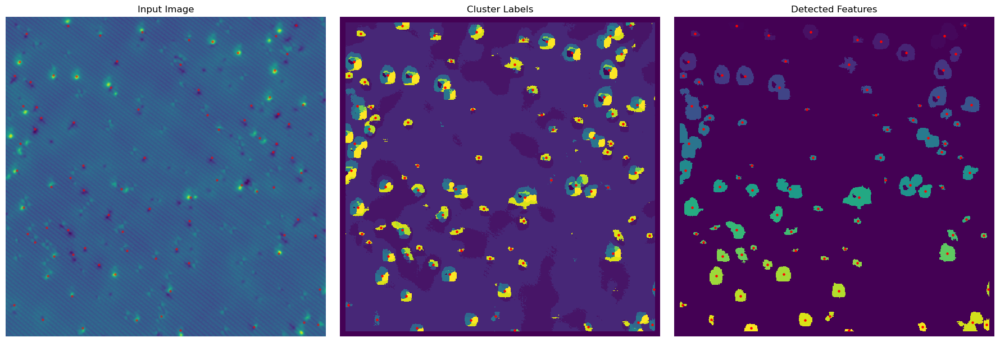

In [145]:
image_num = 0
prediction_file = predict_data_files_list[image_num]  
coords_file = image_windows_coordinates_file_list[image_num]  

#get reconstructed image and cluster image
reconstructed_img, cluster_img = m.reconstruct_predict(prediction_file, coords_file, autoencoder_model, cluster_model, window_size, predictions_batch_size)

data = cluster_img.astype("int32")
print(np.bincount(data.ravel()))

# Detect features and find centers
features, centers, labeled_array, num_features = m.detect_features_find_centres(cluster_img, max_size=70000, area_threshold=64)
#display the images and extracted features
m.display_reconstructed_and_cluster_images_and_extracted_features(
    reconstructed_img, 
    cluster_img, 
    features, 
    centers, 
    save_to_disk=False,
)


---
Processing file default_2011Feb11-105510_STM-STM_Spectroscopy--110_16_BD_all_windows.npy
Not shuffling
Data pipeline created with 1 files, batch size: 32768, window size: 32
Sample batch shape: (32768, 32, 32, 1)
......Combined latent features shape: (189225, 4096)
[ 68252      0    468      0      0      0  17404      0      0      0
      0 374152    192      0 294524     60      0      0    144     56
      0      0   2564  12740     12   5628  17820   8644   7340]


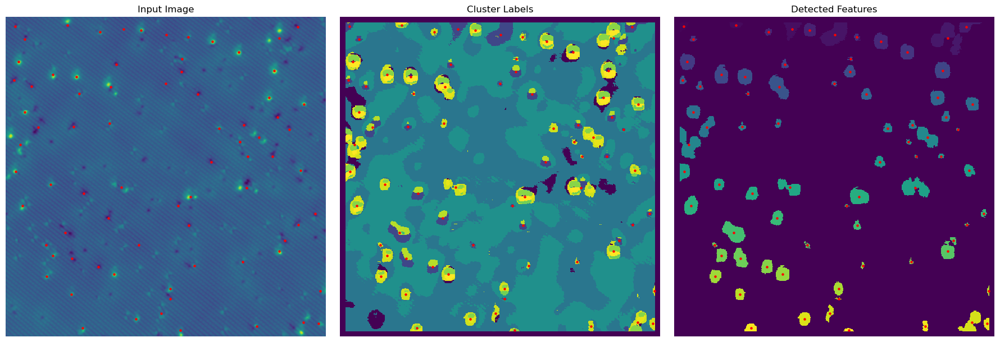

In [39]:
image_num = 0
prediction_file = predict_data_files_list[image_num]  
coords_file = image_windows_coordinates_file_list[image_num]  

#get reconstructed image and cluster image
reconstructed_img, cluster_img = m.reconstruct_predict(prediction_file, coords_file, autoencoder_model, cluster_model, window_size, predictions_batch_size)

data = cluster_img.astype("int32")
print(np.bincount(data.ravel()))

# Detect features and find centers
features, centers, labeled_array, num_features = m.detect_features_find_centres(cluster_img, max_size=70000, area_threshold=64)
#display the images and extracted features
m.display_reconstructed_and_cluster_images_and_extracted_features(
    reconstructed_img, 
    cluster_img, 
    features, 
    centers, 
    save_to_disk=False,
)

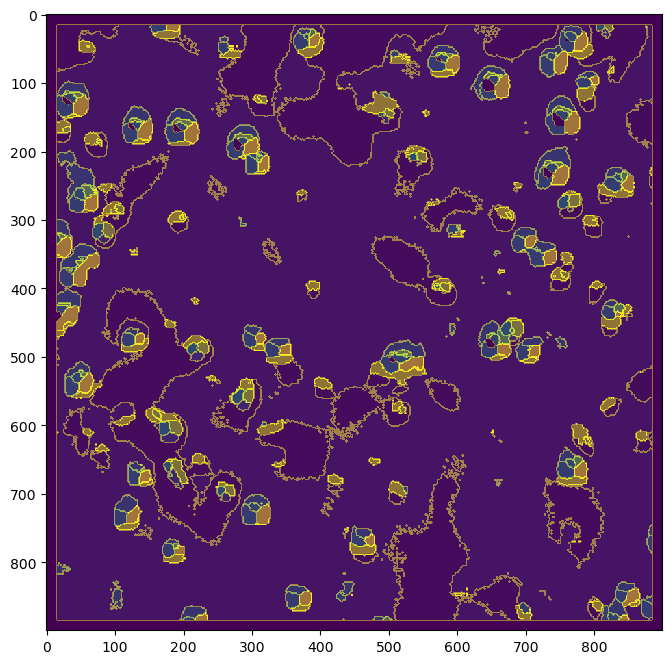

In [146]:
import skimage
#convert reconstructed_img to grayscale if it is not already
#reconstructed_img_gray = skimage.color.rgb2gray(reconstructed_img)
#boundaries = ski.measure.find_contours(features, 0.5)
data = cluster_img.astype("int32")
boundaries = skimage.segmentation.find_boundaries(data, mode="outer")
fig, ax = plt.subplots(figsize=(10, 8))  # Adjust figsize (width, height) as desired
ax.imshow(cluster_img, cmap='viridis', interpolation='nearest')
ax.imshow(boundaries, cmap='viridis', interpolation='nearest', alpha=0.5)  # Overlay boundaries with some transparency


In [147]:
import scipy
# Create a copy to work with
boundary_image = boundaries.astype(int)

# Label connected components (regions between boundaries)
labeled_regions, num_regions = scipy.ndimage.label(~boundaries)

# Calculate area of each region
areas = {}
for region_id in range(1, num_regions + 1):
    area = np.sum(labeled_regions == region_id)
    areas[region_id] = area

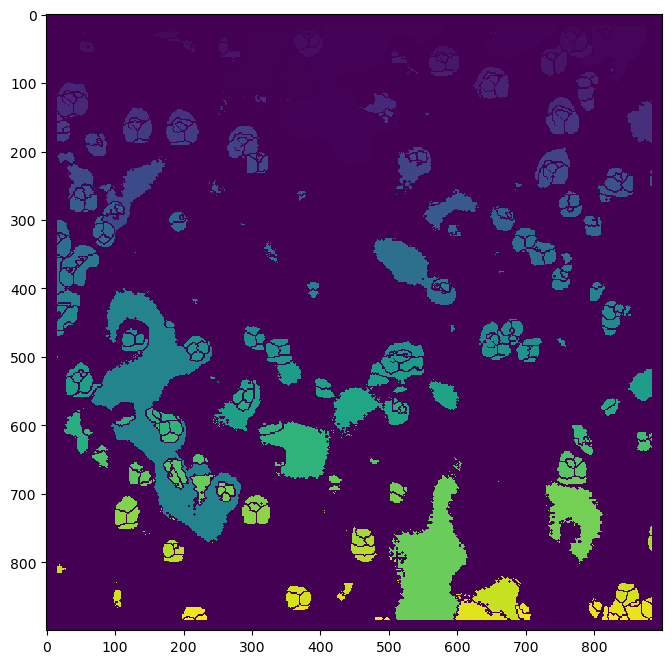

In [148]:
fig, ax = plt.subplots(figsize=(10, 8))  # Adjust figsize (width, height) as desired
ax.imshow(labeled_regions, cmap='viridis', interpolation='nearest')

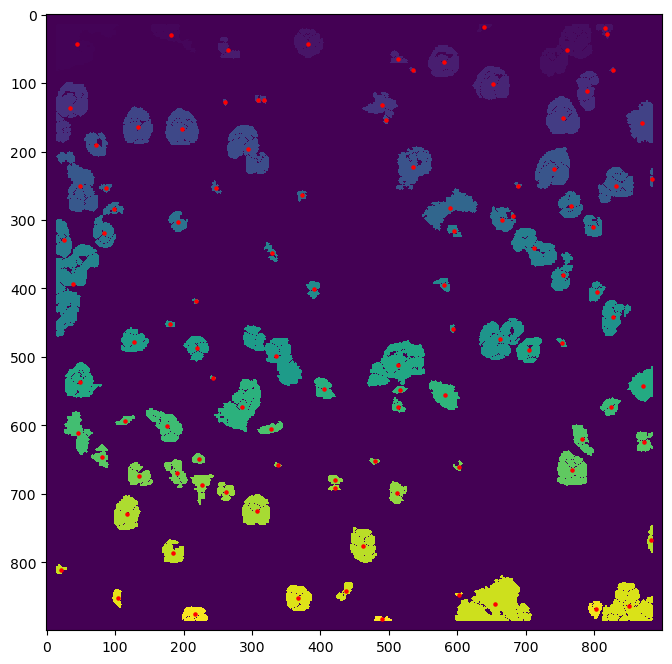

In [149]:
area_threshold = 20  # Define the area threshold for morphological operations
data = cluster_img.astype("int32")
boundaries = skimage.segmentation.find_boundaries(data, mode="outer")

# Create a copy to work with
boundary_image = boundaries.astype(int)

# Label connected components (regions between boundaries)
labeled_regions, num_regions = scipy.ndimage.label(~boundaries)

# Calculate area of each region
areas = {}
for region_id in range(1, num_regions + 1):
    area = np.sum(labeled_regions == region_id)
    areas[region_id] = area
    
large_removed = m.remove_large_objects(labeled_regions, max_size=3000)

area_closed = morphology.area_closing(large_removed, area_threshold=area_threshold)  # Apply closing operation to fill small holes
area_opened = morphology.area_opening(area_closed, area_threshold=area_threshold)  # Apply opening operation to remove small objects

foreground = area_opened > 0  # Convert to boolean type for morphological operations
dilated = morphology.binary_dilation(foreground, morphology.disk(1))  # Dilate the foreground to connect nearby features
labeled_array, num_features = scipy.ndimage.label(dilated)  # Use a 3x3 structure for connectivity

centers = scipy.ndimage.center_of_mass(foreground, labeled_array, range(1, num_features + 1))
centers = np.array(centers)  # Convert to numpy array for easier manipulation


fig, ax = plt.subplots(figsize=(10, 8))  # Adjust figsize (width, height) as desired
ax.imshow(labeled_array, cmap='viridis', interpolation='nearest')
ax.scatter(centers[:,1], centers[:,0], color='red', s=5, label='Centroids')  # Plot centroids

In [43]:
print(areas)

{1: 52064, 2: 380, 3: 8, 4: 4004, 5: 3, 6: 267512, 7: 38, 8: 101, 9: 34, 10: 40199, 11: 1895, 12: 1167, 13: 69, 14: 3032, 15: 5656, 16: 2, 17: 24, 18: 107, 19: 4283, 20: 142, 21: 666, 22: 1, 23: 5, 24: 152, 25: 1, 26: 432, 27: 1, 28: 1, 29: 308, 30: 1, 31: 1, 32: 1, 33: 1, 34: 97, 35: 1, 36: 1, 37: 6, 38: 1, 39: 1, 40: 1, 41: 2, 42: 49, 43: 1, 44: 1, 45: 2, 46: 233, 47: 1, 48: 9, 49: 17, 50: 122, 51: 2, 52: 290, 53: 179, 54: 85, 55: 41, 56: 198, 57: 145, 58: 33, 59: 1, 60: 1, 61: 1, 62: 1, 63: 2, 64: 1643, 65: 3, 66: 1, 67: 1, 68: 152, 69: 1, 70: 1, 71: 354, 72: 143, 73: 1, 74: 1, 75: 406, 76: 1, 77: 1, 78: 16, 79: 1, 80: 1, 81: 1, 82: 1, 83: 1, 84: 34, 85: 1, 86: 1, 87: 2, 88: 44, 89: 165, 90: 1, 91: 311, 92: 2, 93: 97, 94: 1, 95: 1, 96: 184, 97: 1, 98: 1, 99: 1, 100: 164, 101: 6, 102: 229, 103: 16, 104: 1, 105: 269, 106: 6, 107: 1, 108: 1, 109: 1, 110: 1, 111: 1, 112: 1, 113: 1, 114: 10, 115: 2, 116: 1, 117: 1, 118: 5, 119: 98, 120: 56, 121: 18, 122: 478, 123: 426, 124: 1, 125: 80, 1


---
Processing file default_2011Feb11-105510_STM-STM_Spectroscopy--110_16_FD_all_windows.npy
Not shuffling
Data pipeline created with 1 files, batch size: 32768, window size: 32
Sample batch shape: (32768, 32, 32, 1)
......Combined latent features shape: (189225, 4096)


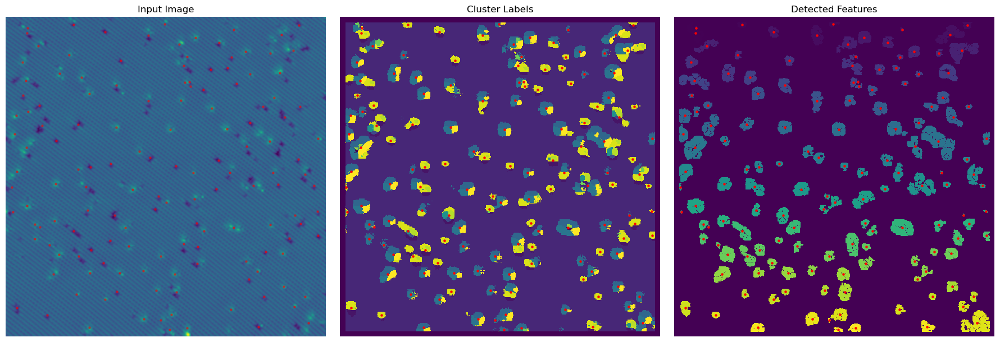

In [150]:
image_num = 2
prediction_file = predict_data_files_list[image_num]  
coords_file = image_windows_coordinates_file_list[image_num]  

#get reconstructed image and cluster image
reconstructed_img, cluster_img = m.reconstruct_predict(prediction_file, coords_file, autoencoder_model, cluster_model, window_size, predictions_batch_size)



# Detect features and find centers
labeled_array, centers, num_features = m.detect_features_better(cluster_img, max_size=3000, area_threshold=50)
#display the images and extracted features
m.display_reconstructed_and_cluster_images_and_extracted_features(
    reconstructed_img, 
    cluster_img, 
    labeled_array, 
    centers, 
    save_to_disk=False,
)

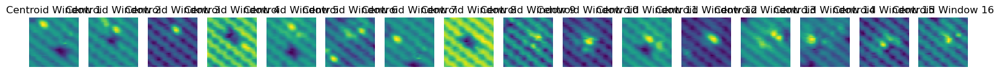

In [155]:
centroid_windows, centers = m.extract_feature_windows(reconstructed_img, centers, px=25)
fig, ax = plt.subplots(1, 16, figsize=(20, 8))  # Adjust figsize (width, height) as desired
for i in range(16):
    ax[i].imshow(centroid_windows[i], cmap='viridis', interpolation='nearest')
    ax[i].set_title(f"Centroid Window {i+1}")
    ax[i].axis('off')  # Remove axis labels

No target folders found to delete.


In [125]:
#windows_full_path = dp.create_folder_path(feature_windows_path, collate=True)
image_name = os.path.splitext(os.path.basename(prediction_file))[0]

dp.save_feature_windows_together(centroid_windows, centers, feature_windows_path, base_filename=image_name, verbose=True)

Saved 129 windows to /hpc/aklicka/Python-data/training-set-1/June_25_BIG_model/feature_windows/default_2011Feb11-105510_STM-STM_Spectroscopy--110_16_FD_all_windows_all_windows.npy
Saved coordinates to /hpc/aklicka/Python-data/training-set-1/June_25_BIG_model/feature_windows/default_2011Feb11-105510_STM-STM_Spectroscopy--110_16_FD_all_windows_coordinates.txt



## Iterate over all prediction images and display original image, clustered image, and the selected features/defects

## BIG model


---
Processing file default_2011Feb11-105510_STM-STM_Spectroscopy--110_16_BD_all_windows.npy
Not shuffling
Data pipeline created with 1 files, batch size: 32768, window size: 32
Sample batch shape: (32768, 32, 32, 1)
......Combined latent features shape: (189225, 4096)


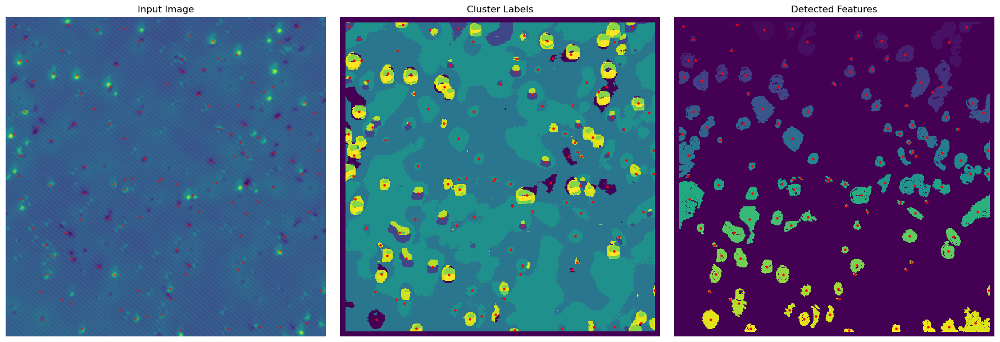


---
Processing file default_2011Feb11-105510_STM-STM_Spectroscopy--110_16_BU_all_windows.npy
Not shuffling
Data pipeline created with 1 files, batch size: 32768, window size: 32
Sample batch shape: (32768, 32, 32, 1)
......Combined latent features shape: (189225, 4096)


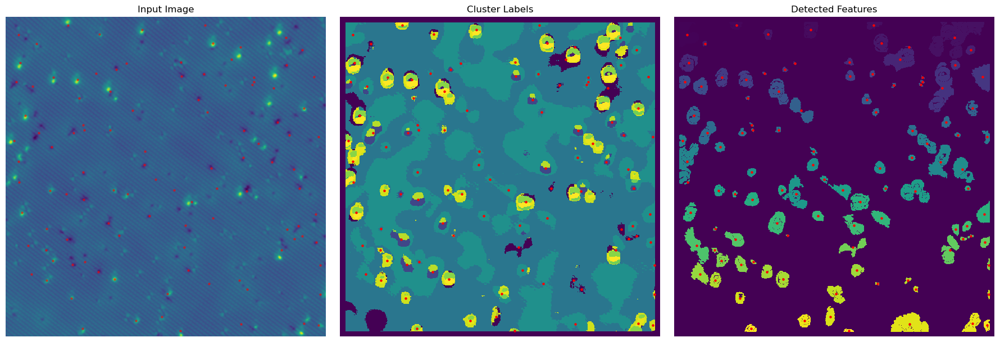


---
Processing file default_2011Feb11-105510_STM-STM_Spectroscopy--110_16_FD_all_windows.npy
Not shuffling
Data pipeline created with 1 files, batch size: 32768, window size: 32
Sample batch shape: (32768, 32, 32, 1)
......Combined latent features shape: (189225, 4096)


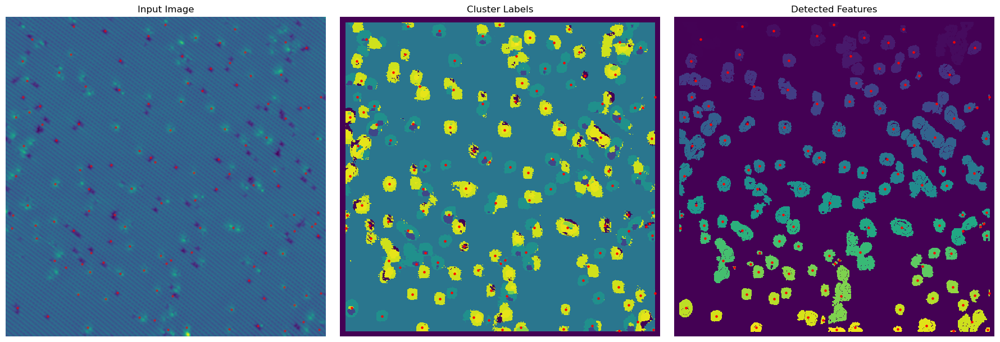


---
Processing file default_2011Feb11-105510_STM-STM_Spectroscopy--110_16_FU_all_windows.npy
Not shuffling
Data pipeline created with 1 files, batch size: 32768, window size: 32
Sample batch shape: (32768, 32, 32, 1)
......Combined latent features shape: (189225, 4096)


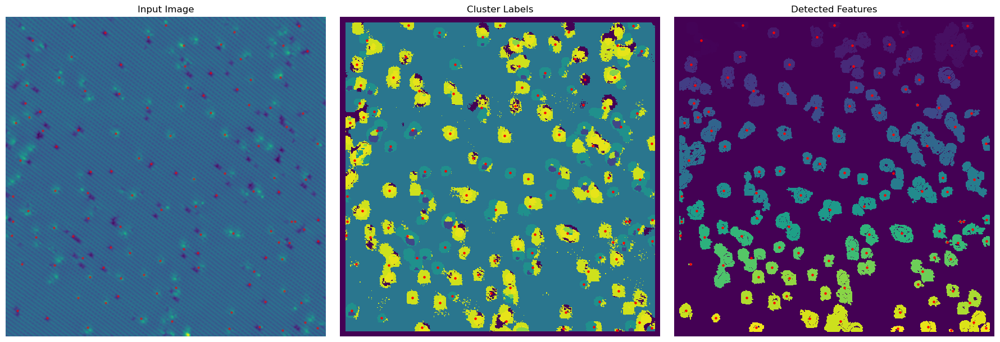


---
Processing file default_2011Mar10-162902_STM-STM_Spectroscopy--1_3_BD_all_windows.npy
Not shuffling
Data pipeline created with 1 files, batch size: 32768, window size: 32
Sample batch shape: (18225, 32, 32, 1)
.Combined latent features shape: (18225, 4096)


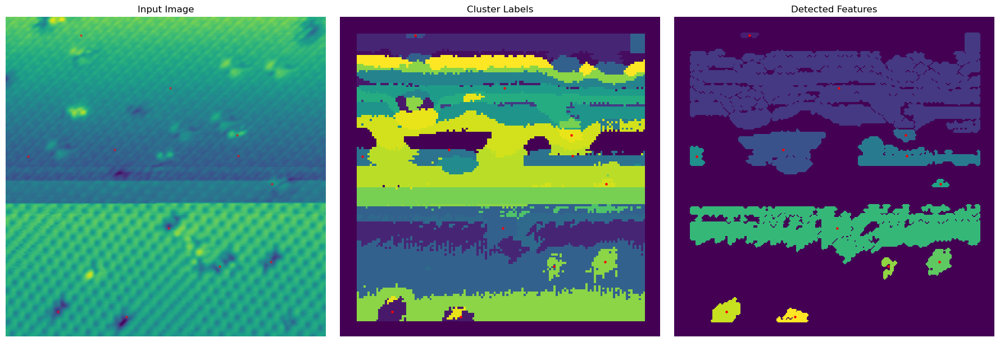


---
Processing file default_2011Mar10-162902_STM-STM_Spectroscopy--1_3_BU_all_windows.npy
Not shuffling
Data pipeline created with 1 files, batch size: 32768, window size: 32
Sample batch shape: (18225, 32, 32, 1)
.Combined latent features shape: (18225, 4096)


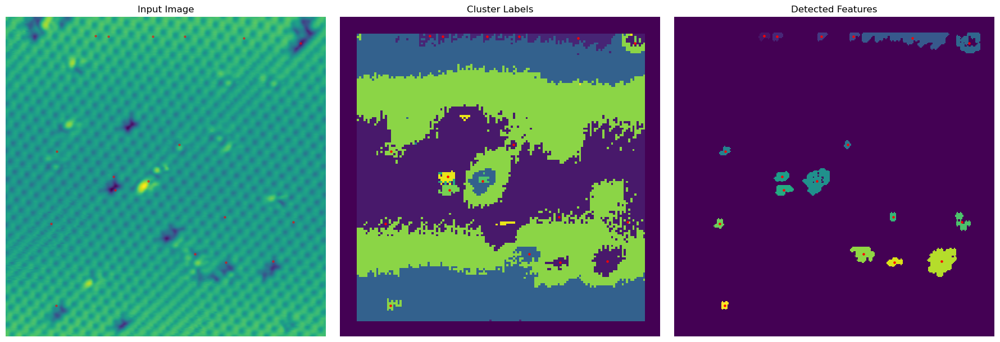


---
Processing file default_2011Mar10-162902_STM-STM_Spectroscopy--1_3_FD_all_windows.npy
Not shuffling
Data pipeline created with 1 files, batch size: 32768, window size: 32
Sample batch shape: (18225, 32, 32, 1)
.Combined latent features shape: (18225, 4096)


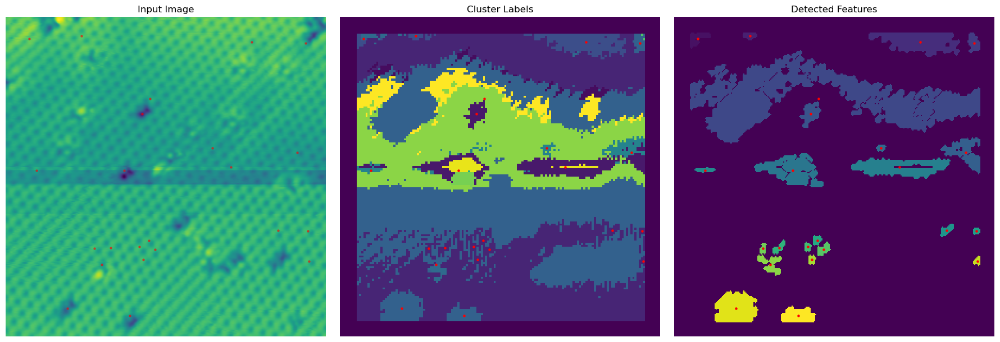


---
Processing file default_2011Mar10-162902_STM-STM_Spectroscopy--1_3_FU_all_windows.npy
Not shuffling
Data pipeline created with 1 files, batch size: 32768, window size: 32
Sample batch shape: (18225, 32, 32, 1)
.Combined latent features shape: (18225, 4096)


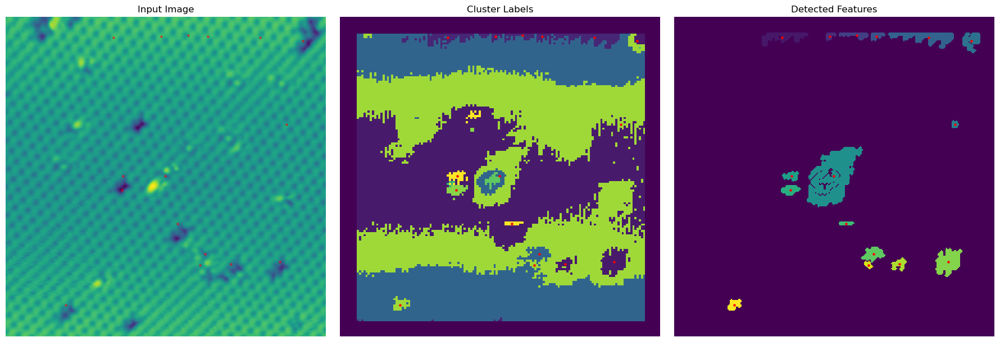


---
Processing file default_2011Mar17-102654_STM-STM_Spectroscopy--1_2_BU_all_windows.npy
Not shuffling
Data pipeline created with 1 files, batch size: 32768, window size: 32
Sample batch shape: (32768, 32, 32, 1)
...Combined latent features shape: (72390, 4096)


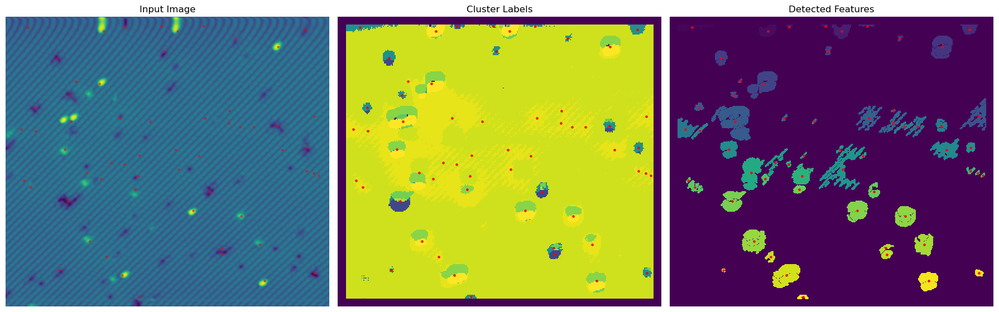


---
Processing file default_2011Mar17-102654_STM-STM_Spectroscopy--1_2_FU_all_windows.npy
Not shuffling
Data pipeline created with 1 files, batch size: 32768, window size: 32
Sample batch shape: (32768, 32, 32, 1)
...Combined latent features shape: (72390, 4096)


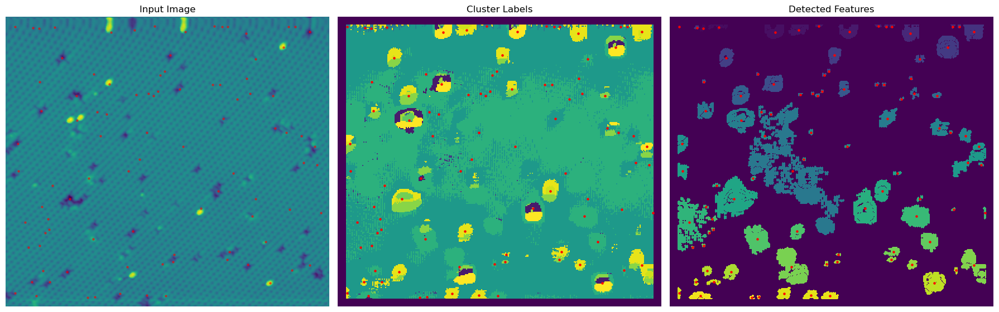


---
Processing file default_2011May27-164015_STM-STM_Spectroscopy--22_4_BD_all_windows.npy
Not shuffling
Data pipeline created with 1 files, batch size: 32768, window size: 32
Sample batch shape: (18225, 32, 32, 1)
.Combined latent features shape: (18225, 4096)


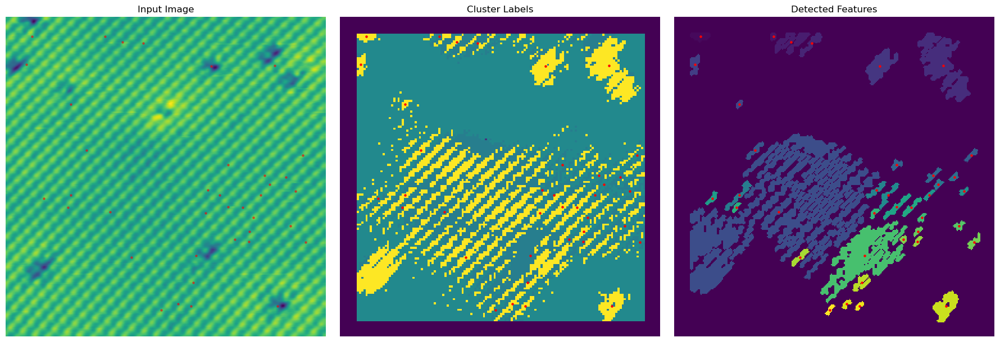


---
Processing file default_2011May27-164015_STM-STM_Spectroscopy--22_4_BU_all_windows.npy
Not shuffling
Data pipeline created with 1 files, batch size: 32768, window size: 32
Sample batch shape: (18225, 32, 32, 1)
.Combined latent features shape: (18225, 4096)


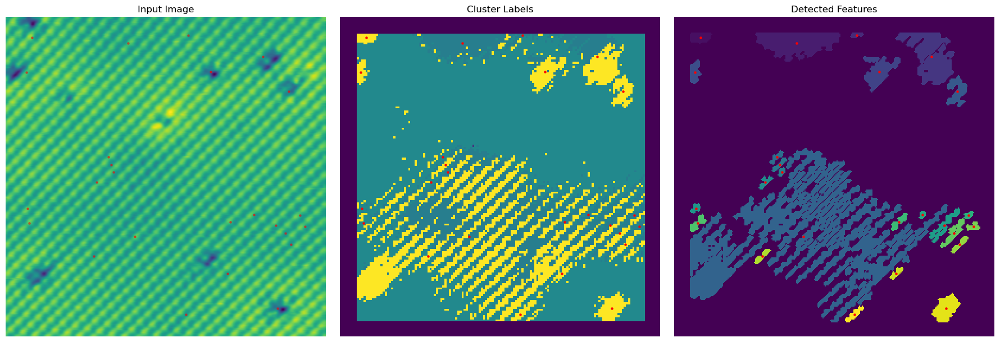


---
Processing file default_2011May27-164015_STM-STM_Spectroscopy--22_4_FD_all_windows.npy
Not shuffling
Data pipeline created with 1 files, batch size: 32768, window size: 32
Sample batch shape: (18225, 32, 32, 1)
.Combined latent features shape: (18225, 4096)


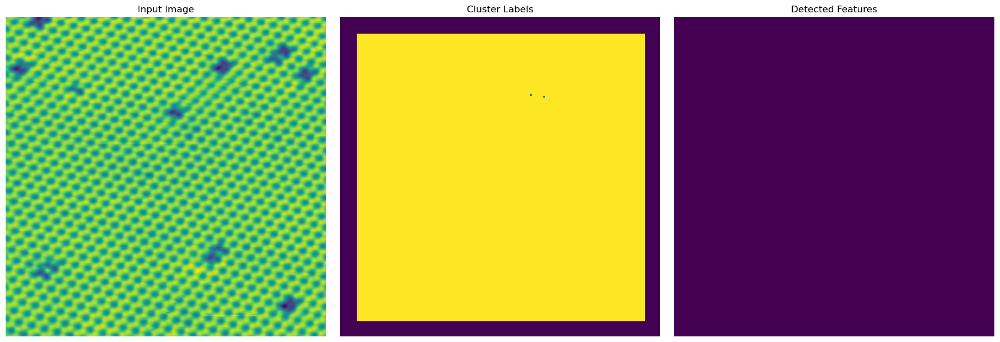


---
Processing file default_2011May27-164015_STM-STM_Spectroscopy--22_4_FU_all_windows.npy
Not shuffling
Data pipeline created with 1 files, batch size: 32768, window size: 32
Sample batch shape: (18225, 32, 32, 1)
.Combined latent features shape: (18225, 4096)


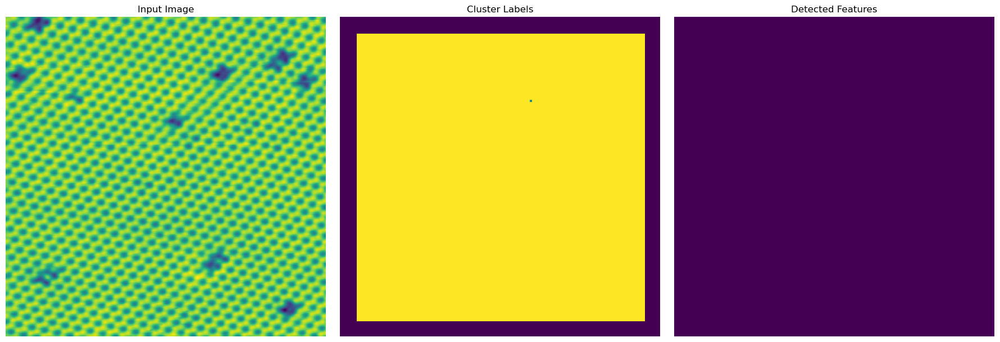


---
Processing file default_2013Mar22-133720_STM-STM_Spectroscopy--44_2_BU_all_windows.npy
Not shuffling
Data pipeline created with 1 files, batch size: 32768, window size: 32
Sample batch shape: (32768, 32, 32, 1)
...Combined latent features shape: (81225, 4096)


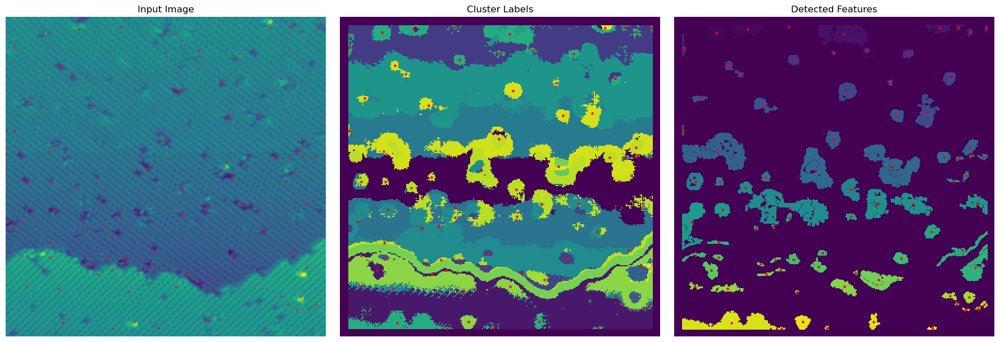


---
Processing file default_2013Mar22-133720_STM-STM_Spectroscopy--44_2_FU_all_windows.npy
Not shuffling
Data pipeline created with 1 files, batch size: 32768, window size: 32
Sample batch shape: (32768, 32, 32, 1)
...Combined latent features shape: (81225, 4096)


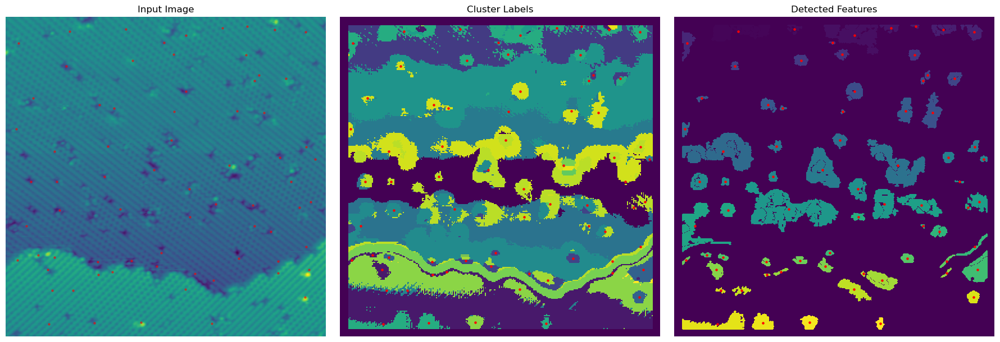


---
Processing file default_2014Aug06-115806_STM-STM_Spectroscopy--12_2_BD_all_windows.npy
Not shuffling
Data pipeline created with 1 files, batch size: 32768, window size: 32
Sample batch shape: (32768, 32, 32, 1)
...Combined latent features shape: (81225, 4096)


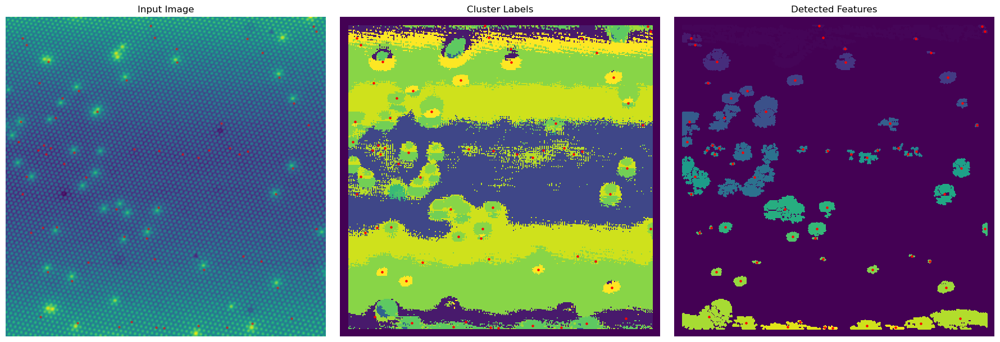


---
Processing file default_2014Aug06-115806_STM-STM_Spectroscopy--12_2_BU_all_windows.npy
Not shuffling
Data pipeline created with 1 files, batch size: 32768, window size: 32
Sample batch shape: (32768, 32, 32, 1)
...Combined latent features shape: (81225, 4096)


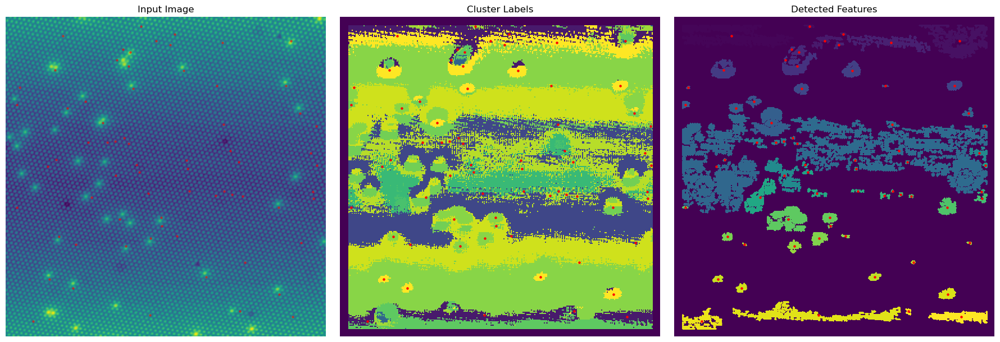


---
Processing file default_2014Aug06-115806_STM-STM_Spectroscopy--12_2_FD_all_windows.npy
Not shuffling
Data pipeline created with 1 files, batch size: 32768, window size: 32
Sample batch shape: (32768, 32, 32, 1)
...Combined latent features shape: (81225, 4096)


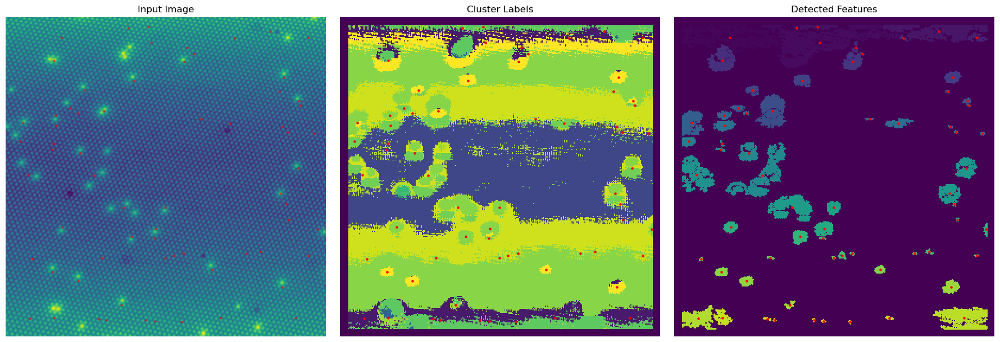


---
Processing file default_2014Aug06-115806_STM-STM_Spectroscopy--12_2_FU_all_windows.npy
Not shuffling
Data pipeline created with 1 files, batch size: 32768, window size: 32
Sample batch shape: (32768, 32, 32, 1)
...Combined latent features shape: (81225, 4096)


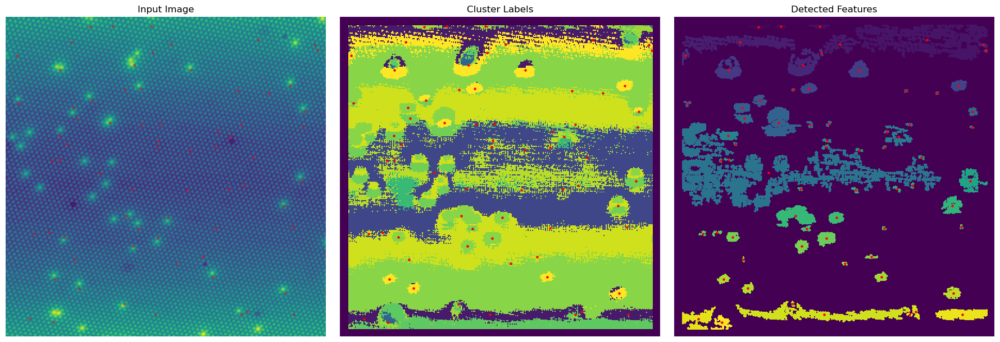


---
Processing file default_2022Jan12-130324_STM-STM_Spectroscopy--2_3_BD_all_windows.npy
Not shuffling
Data pipeline created with 1 files, batch size: 32768, window size: 32
Sample batch shape: (32768, 32, 32, 1)
....Combined latent features shape: (129600, 4096)


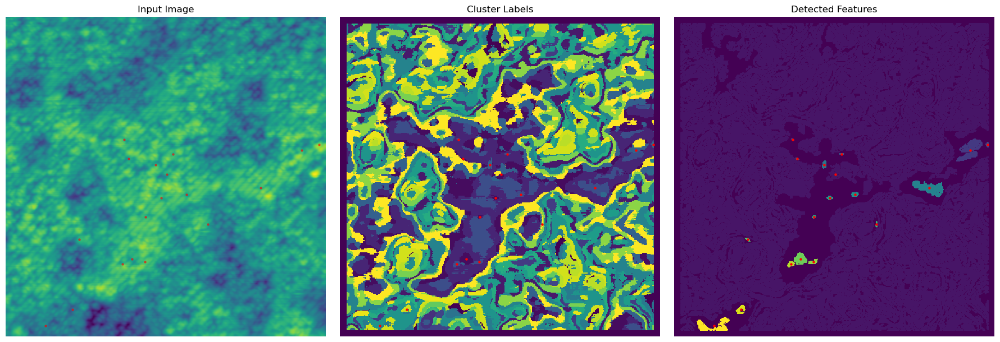


---
Processing file default_2022Jan12-130324_STM-STM_Spectroscopy--2_3_BU_all_windows.npy
Not shuffling
Data pipeline created with 1 files, batch size: 32768, window size: 32
Sample batch shape: (32768, 32, 32, 1)
....Combined latent features shape: (129600, 4096)


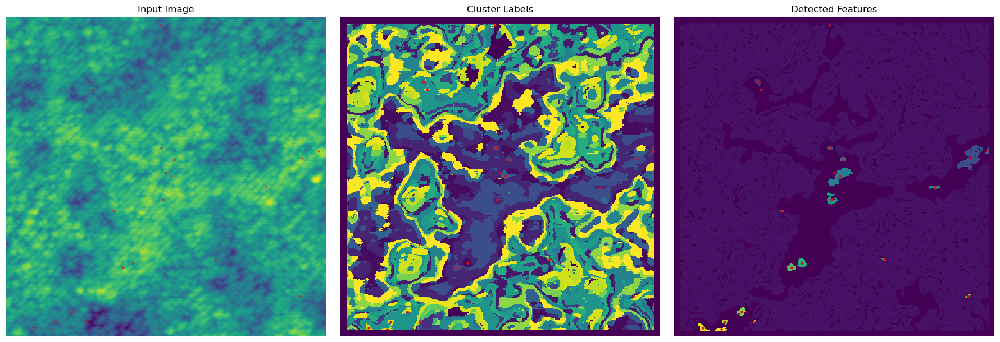


---
Processing file default_2022Jan12-130324_STM-STM_Spectroscopy--2_3_FD_all_windows.npy
Not shuffling
Data pipeline created with 1 files, batch size: 32768, window size: 32
Sample batch shape: (32768, 32, 32, 1)
....Combined latent features shape: (129600, 4096)


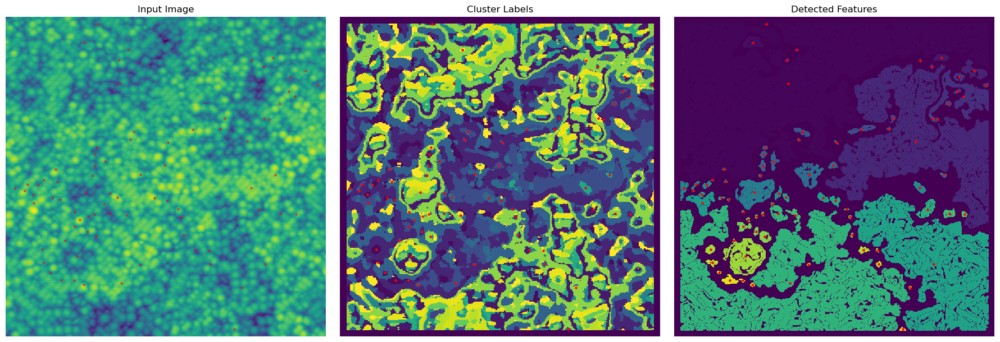


---
Processing file default_2022Jan12-130324_STM-STM_Spectroscopy--2_3_FU_all_windows.npy
Not shuffling
Data pipeline created with 1 files, batch size: 32768, window size: 32
Sample batch shape: (32768, 32, 32, 1)
....Combined latent features shape: (129600, 4096)


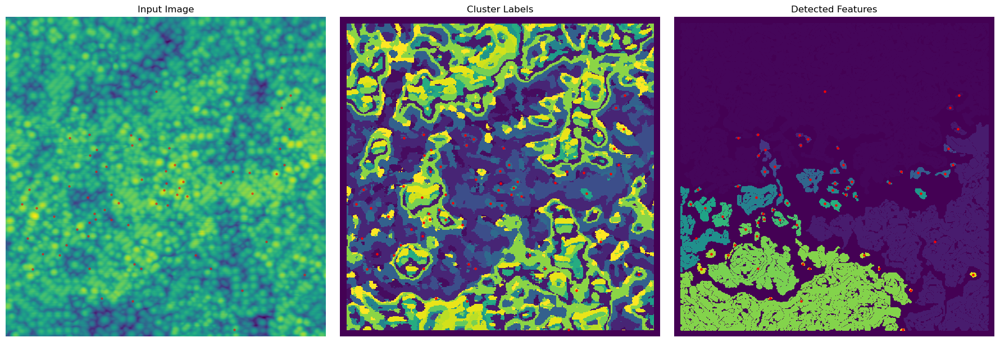


---
Processing file default_2024Aug07-153010_STM-STM_Spectroscopy--8_1_BD_all_windows.npy
Not shuffling
Data pipeline created with 1 files, batch size: 32768, window size: 32
Sample batch shape: (32768, 32, 32, 1)
....Combined latent features shape: (129600, 4096)


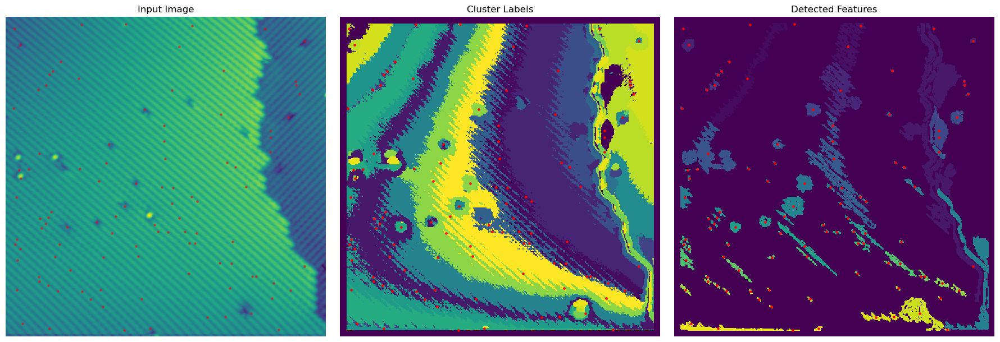


---
Processing file default_2024Aug07-153010_STM-STM_Spectroscopy--8_1_BU_all_windows.npy
Not shuffling
Data pipeline created with 1 files, batch size: 32768, window size: 32
Sample batch shape: (32768, 32, 32, 1)
....Combined latent features shape: (129600, 4096)


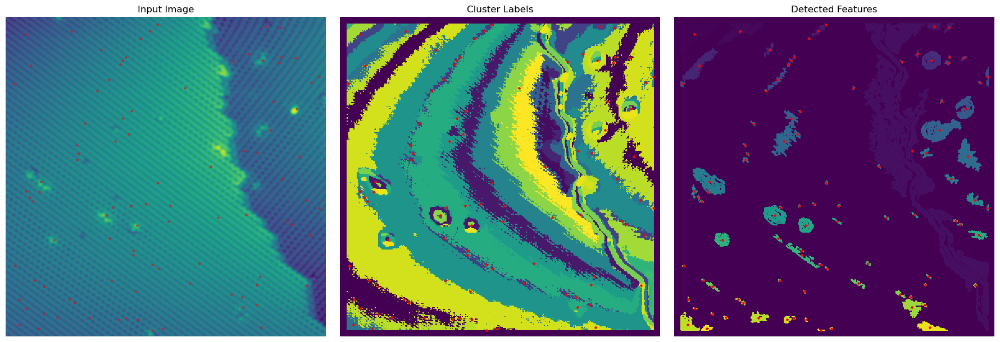


---
Processing file default_2024Aug07-153010_STM-STM_Spectroscopy--8_1_FD_all_windows.npy
Not shuffling
Data pipeline created with 1 files, batch size: 32768, window size: 32
Sample batch shape: (32768, 32, 32, 1)
....Combined latent features shape: (129600, 4096)


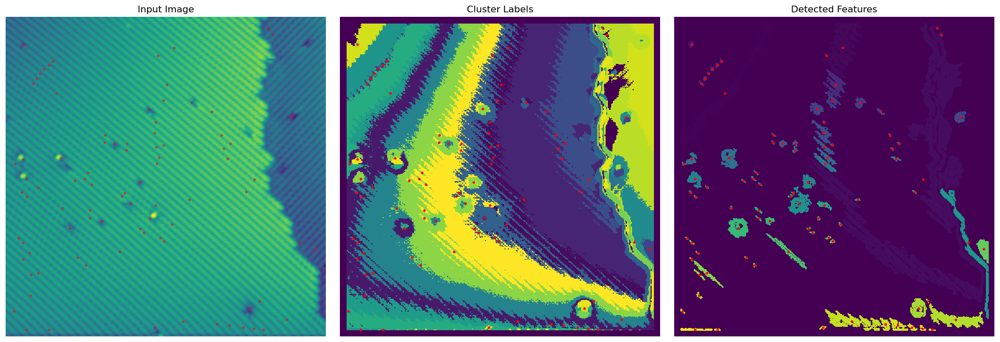


---
Processing file default_2024Aug07-153010_STM-STM_Spectroscopy--8_1_FU_all_windows.npy
Not shuffling
Data pipeline created with 1 files, batch size: 32768, window size: 32
Sample batch shape: (32768, 32, 32, 1)
....Combined latent features shape: (129600, 4096)


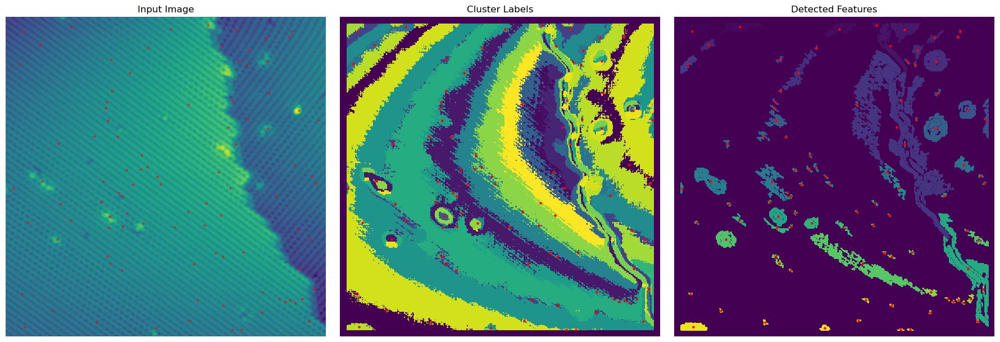


---
Processing file default_2024Aug07-153010_STM-STM_Spectroscopy--9_1_BD_all_windows.npy
Not shuffling
Data pipeline created with 1 files, batch size: 32768, window size: 32
Sample batch shape: (32768, 32, 32, 1)
....Combined latent features shape: (129600, 4096)


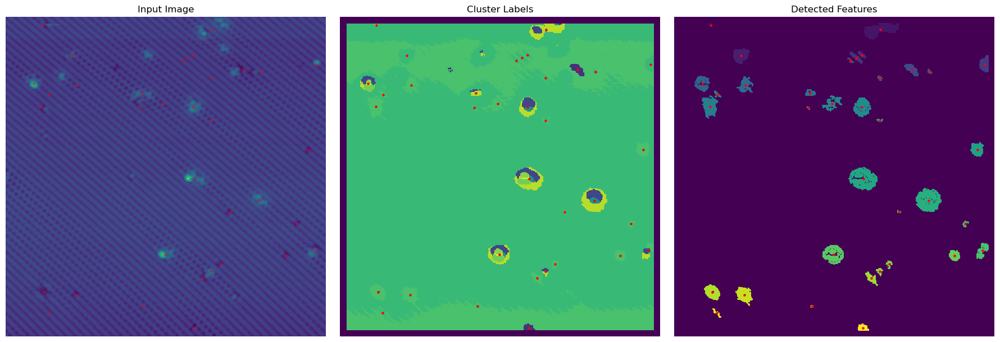


---
Processing file default_2024Aug07-153010_STM-STM_Spectroscopy--9_1_BU_all_windows.npy
Not shuffling
Data pipeline created with 1 files, batch size: 32768, window size: 32
Sample batch shape: (32768, 32, 32, 1)
....Combined latent features shape: (129600, 4096)


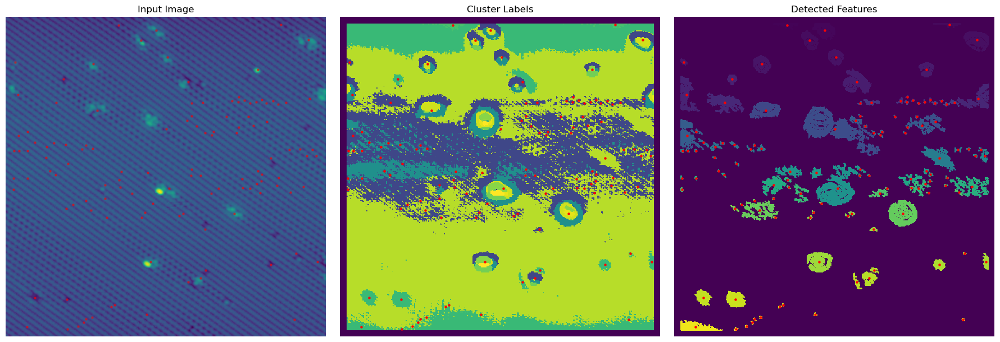


---
Processing file default_2024Aug07-153010_STM-STM_Spectroscopy--9_1_FD_all_windows.npy
Not shuffling
Data pipeline created with 1 files, batch size: 32768, window size: 32
Sample batch shape: (32768, 32, 32, 1)
....Combined latent features shape: (129600, 4096)


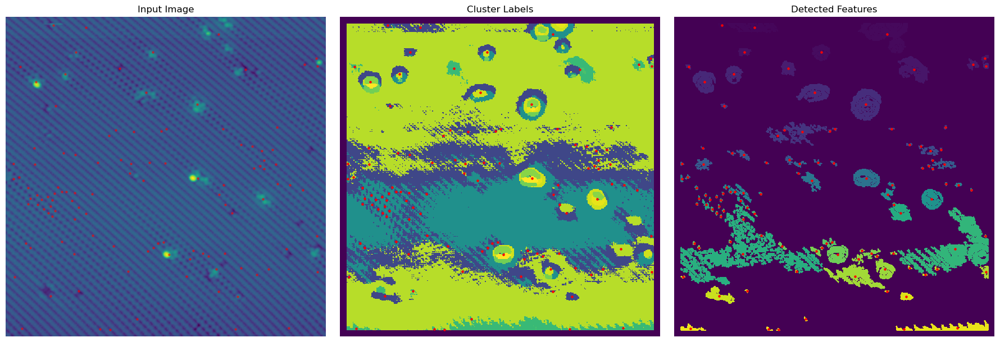


---
Processing file default_2024Aug07-153010_STM-STM_Spectroscopy--9_1_FU_all_windows.npy
Not shuffling
Data pipeline created with 1 files, batch size: 32768, window size: 32
Sample batch shape: (32768, 32, 32, 1)
....Combined latent features shape: (129600, 4096)


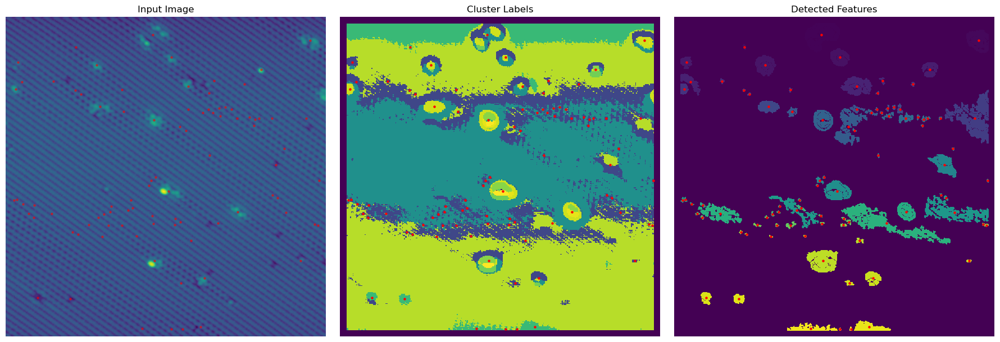

In [ ]:
dp.delete_data_folders(job_data_path, subdirectories=["feature_windows"], override=True)

for image_num in range(len(predict_data_files_list)):
    prediction_file = predict_data_files_list[image_num]  
    coords_file = image_windows_coordinates_file_list[image_num]  

    #get reconstructed image and cluster image
    reconstructed_img, cluster_img = m.reconstruct_predict(prediction_file, coords_file, autoencoder_model, cluster_model, window_size, predictions_batch_size)

    # Detect features and find centers
    labeled_array, centers, num_features = m.detect_features_better(cluster_img, max_size=3000, area_threshold=50)

    #extract feature windows from the reconstructed image
    feature_windows = m.extract_feature_windows(reconstructed_img, centers, px=25)

    image_name = os.path.splitext(os.path.basename(prediction_file))[0]
    # Save the feature windows to disk for each reconstructed image
    dp.save_feature_windows_together(feature_windows, centers, feature_windows_path, base_filename=image_name, verbose=True)

    #save / display the reconstructed and cluster images with centers highlighted
    #m.display_reconstructed_and_cluster_images_and_extracted_features(reconstructed_img, cluster_img, labeled_array, centers, save_to_disk=False,)

In [126]:
#for i in range(int(np.max(cluster_img))+1):
#    plt.imshow(cluster_img==i, cmap='viridis')
#    plt.show()